# <center>GRIP - The Spark Foundation</center>
<img src='https://media.glassdoor.com/sqll/2143300/the-sparks-foundation-squarelogo-1556515236044.png' width="100" height="100">

### <center><font color=7E4456>Data Science and Business Analytics Internship</font></center>  
### <center><font color=7E4456>By Khushboo Hiten Lodaya</font></center>

<font color=155E64>Task 4 : Exploratory Data Analysis - Terrorism</font>

<font color=155E64>(Level - Intermediate)</font>



In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math

In [4]:
df = pd.read_csv('globalterrorismdb_0718dist.csv',encoding='ISO-8859-1')
df.head(5)

C:\Users\91961\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [5]:
# Renaming the columns and using only those columns that are useful for visualisation
df.rename(columns={'eventid':'EventId','iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','provstate':'State',
                   'region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed',
                   'nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type',
                   'weaptype1_txt':'Weapon_type','motive':'Motive','city':'City'},inplace=True)

df=df[['EventId','Year','Month','Day','Country','State','Region','City','latitude','longitude','AttackType',
             'Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 19 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   EventId      181691 non-null  int64  
 1   Year         181691 non-null  int64  
 2   Month        181691 non-null  int64  
 3   Day          181691 non-null  int64  
 4   Country      181691 non-null  object 
 5   State        181270 non-null  object 
 6   Region       181691 non-null  object 
 7   City         181257 non-null  object 
 8   latitude     177135 non-null  float64
 9   longitude    177134 non-null  float64
 10  AttackType   181691 non-null  object 
 11  Killed       171378 non-null  float64
 12  Wounded      165380 non-null  float64
 13  Target       181055 non-null  object 
 14  Summary      115562 non-null  object 
 15  Group        181691 non-null  object 
 16  Target_type  181691 non-null  object 
 17  Weapon_type  181691 non-null  object 
 18  Motive       50561 non-n

In [6]:
df['Wounded']=df['Wounded'].fillna(0).astype(int)
df['Killed']=df['Killed'].fillna(0).astype(int)
df['casualities'] = df['Killed']+ df['Wounded']
df.head(5)

,EventId,Year,Month,Day,Country,State,Region,City,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,casualities
0,197000000001,1970,7,2,Dominican Republic,NaN,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1,0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1
1,197000000002,1970,0,0,Mexico,Federal,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0,0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0
2,197001000001,1970,1,0,Philippines,Tarlac,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1,0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN,1
3,197001000002,1970,1,0,Greece,Attica,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,0,0,U.S. Embassy,NaN,Unknown,Government (Diplomatic),Explosives,NaN,0
4,197001000003,1970,1,0,Japan,Fukouka,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,0,0,U.S. Consulate,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,0


# Data Exploration

## Top 5 Countries with terrorist attacks

In [7]:
for i in range(0,5):
    print(f"{i+1}. {df.Country.value_counts().index[i]} with {df.Country.value_counts()[i]} attacks")

1. Iraq with 24636 attacks
2. Pakistan with 14368 attacks
3. Afghanistan with 12731 attacks
4. India with 11960 attacks
5. Colombia with 8306 attacks


## Top 5 Regions with terrorist attacks

In [8]:
for i in range(0,5):
    print(f"{i+1}. {df.Region.value_counts().index[i]} with {df.Region.value_counts()[i]} attacks.")


1. Middle East & North Africa with 50474 attacks.
2. South Asia with 44974 attacks.
3. South America with 18978 attacks.
4. Sub-Saharan Africa with 17550 attacks.
5. Western Europe with 16639 attacks.


## Basic Analysis of dataset

In [10]:
print(df['Year'].value_counts().idxmax(),'is the most attacked year with', df['Year'].value_counts().max(),'attacks')
print('The most attacked month is the',df['Month'].value_counts().idxmax(),'th month with',df['Month'].value_counts().max(),'attacks')
print(df['Group'].value_counts().index[1],'is the most attacked group with',df['Group'].value_counts().max(),'attacks')
print(df['AttackType'].value_counts().idxmax(),'is the most common type of attack')

2014 is the most attacked year with 16903 attacks
The most attacked month is the 5 th month with 16875 attacks
Taliban is the most attacked group with 82782 attacks
Bombing/Explosion is the most common type of attack


##  Heatmap to graphically represent the correlation of data

In [11]:
df.corr()

,Year,Month,Day,latitude,longitude,Killed,Wounded,casualities
Year,1.000000,0.000139,0.018254,0.166933,0.003917,0.021252,0.017484,0.020675
Month,0.000139,1.000000,0.005497,-0.015978,-0.003880,0.004031,0.003178,0.003805
Day,0.018254,0.005497,1.000000,0.003423,-0.002285,-0.003225,-0.001082,-0.001808
latitude,0.166933,-0.015978,0.003423,1.000000,0.001463,-0.013170,0.015921,0.009899
longitude,0.003917,-0.003880,-0.002285,0.001463,1.000000,-0.000587,0.000205,0.000013
Killed,0.021252,0.004031,-0.003225,-0.013170,-0.000587,1.000000,0.443326,0.651885
Wounded,0.017484,0.003178,-0.001082,0.015921,0.000205,0.443326,1.000000,0.968724
casualities,0.020675,0.003805,-0.001808,0.009899,0.000013,0.651885,0.968724,1.000000


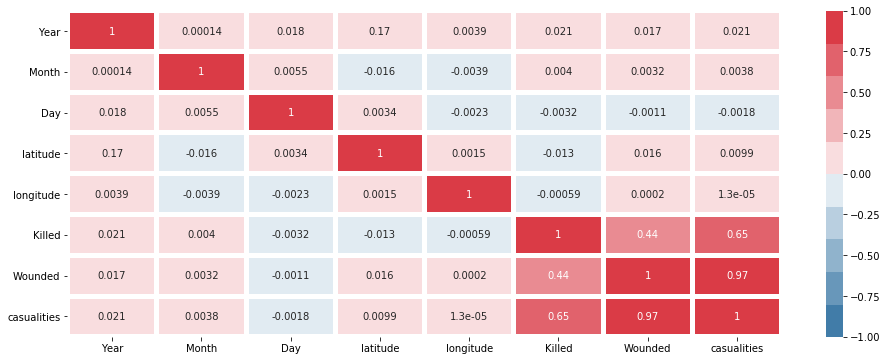

In [12]:
# Graphical representation of the above correlation
#darker the color higher is the magnitude of that phenomenon to occur.
plt.figure(figsize=(16, 6))
sns.heatmap(df.corr(),annot=True,vmin=-1, vmax=1, linewidths=4,cmap=sns.diverging_palette(240, 10, n=10));

##  Terrorist Activities over the years

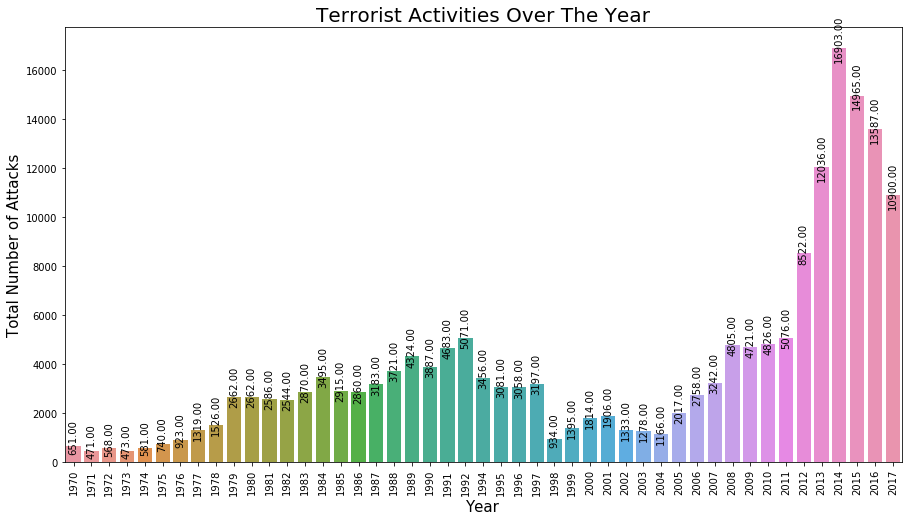

In [13]:
plt.subplots(figsize=(15,8))
ax = sns.countplot('Year', data=df)
plt.xlabel("Year", size=15)
plt.ylabel("Total Number of Attacks", size=15)
plt.xticks(rotation=90)
plt.title('Terrorist Activities Over The Year',size=20)
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'center', xytext = (0, 10),textcoords = 'offset points',  rotation=90)


plt.show()

<font color=155E64>The attacks rised in the year 2012 and in the year 2015 and 2016 the attacks were at its peak</font>

## Percentage of Terror Attacks in different Countries 

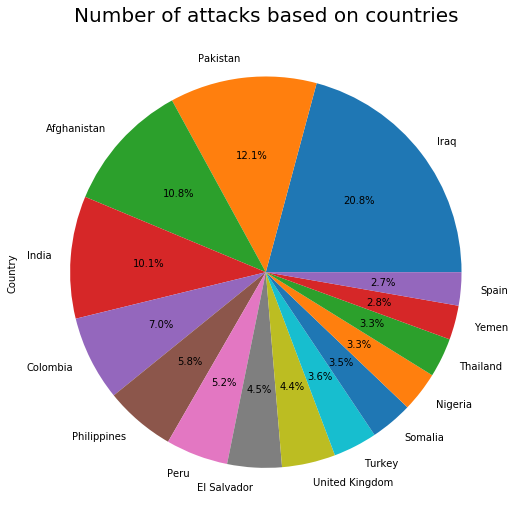

In [14]:
plt.figure(figsize=(9,9))
df['Country'].value_counts()[:15].plot(kind='pie',autopct='%1.1f%%')
plt.title('Number of attacks based on countries', size=20)
plt.show()

## Casualities due to Terrorist Attacks 

Text(0.5, 1.0, 'Casualities Over The Year')

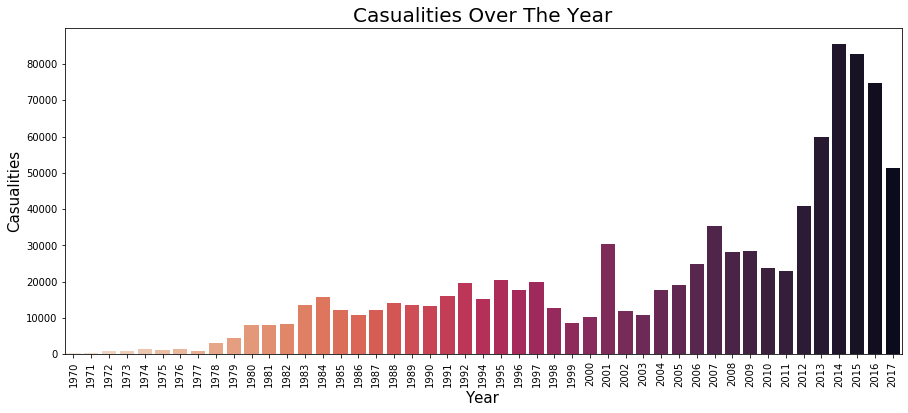

In [15]:
plt.subplots(figsize=(15,6))
cas = df.groupby('Year').casualities.sum().to_frame().reset_index()
cas.columns = ['Year','casualities']
sns.barplot(x = cas.Year, y =cas.casualities, data=df, palette="rocket_r",ci = None)
plt.xlabel("Year", size=15)
plt.ylabel("Casualities", size=15)
plt.xticks(rotation=90)
plt.title('Casualities Over The Year',size=20)

<font color=155E64>It can be seen that 2012 was the start of major terrorist attacks and from 2014 to 2016 the numbers were at its peak. </font>

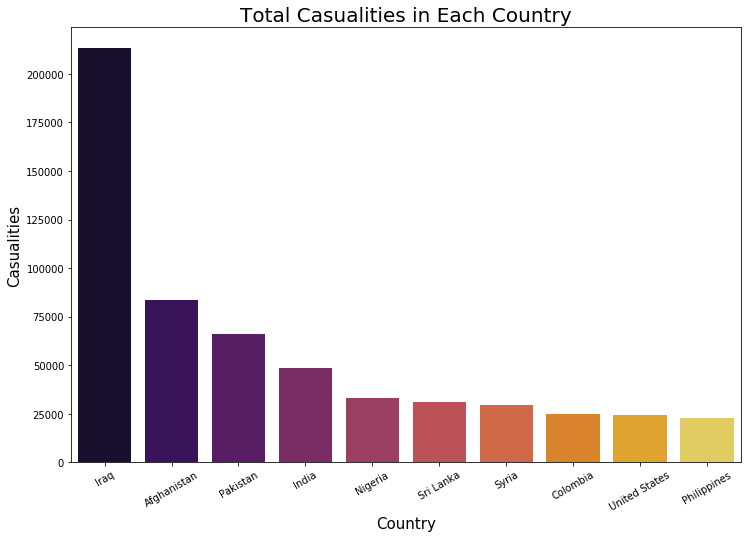

In [20]:
plt.subplots(figsize=(12,8))
cnt_cas = df.groupby('Country').casualities.sum().to_frame().reset_index().sort_values('casualities', ascending=False)[:10]
sns.barplot(x=cnt_cas.Country, y=cnt_cas.casualities, palette= 'inferno')
plt.xticks(rotation=30)
plt.xlabel("Country", size=15)
plt.ylabel("Casualities", size=15)
plt.title('Total Casualities in Each Country', size=20)
plt.show()

<font color=155E64>Iraq stands at top with more than 2,00,000 casualities followed by Afghanistan and Pakistan. </font>

## Regions affected by terrrorist activities

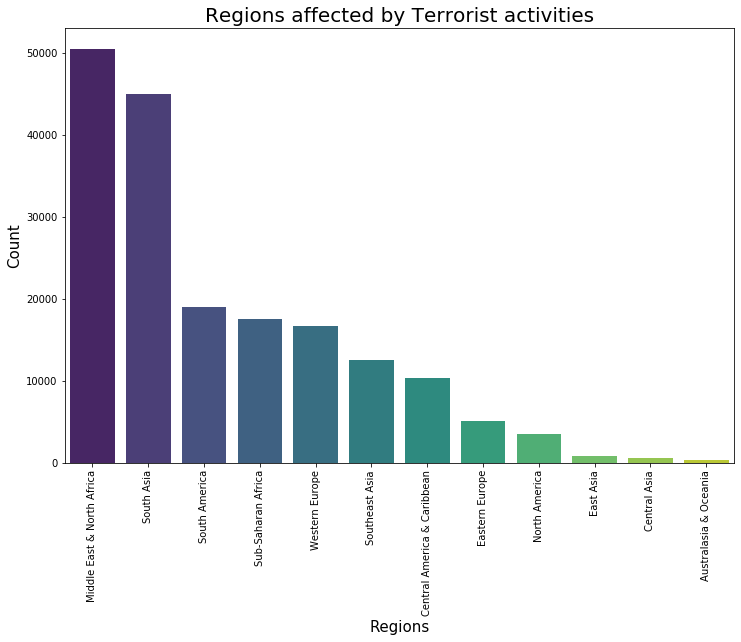

In [19]:
plt.subplots(figsize=(12,8))
sns.countplot('Region', data=df,palette='viridis',order=df['Region'].value_counts().index)
plt.title('Regions affected by Terrorist activities', size=20)
plt.xlabel('Regions', size=15)
plt.ylabel('Count', size=15)
plt.xticks(rotation= 90)
plt.show()

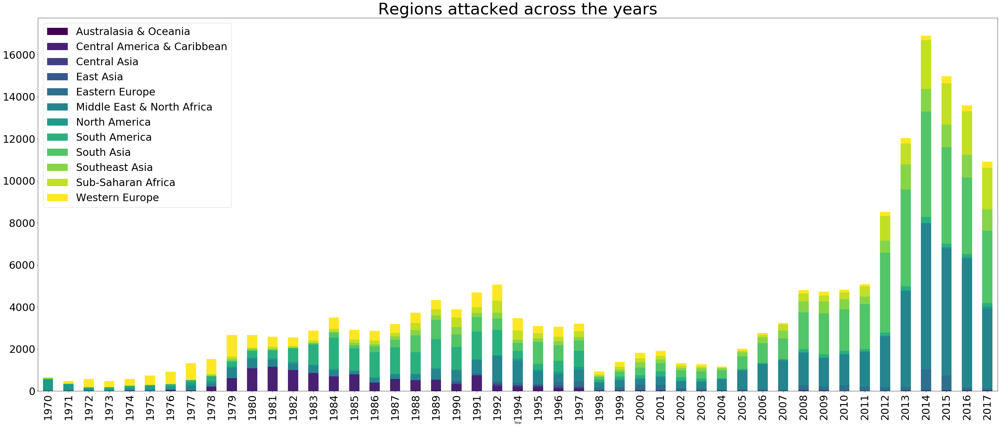

In [18]:
df1 = df.groupby(['Region', 'Year']).size().reset_index().pivot(columns='Region', index='Year', values=0)
df1.plot(kind = 'bar', stacked = True, figsize = (50,20), colormap = 'viridis')
plt.legend(loc=2, prop = {'size':30})
plt.xticks(fontsize = 30)
plt.yticks(fontsize = 30)
plt.title("Regions attacked across the years", fontsize = 47)
plt.show()

<font color=155E64>South Asia, Middle East and North Africa are the most affected regions by terrorist activities</font>

## Terrorist activities by Region

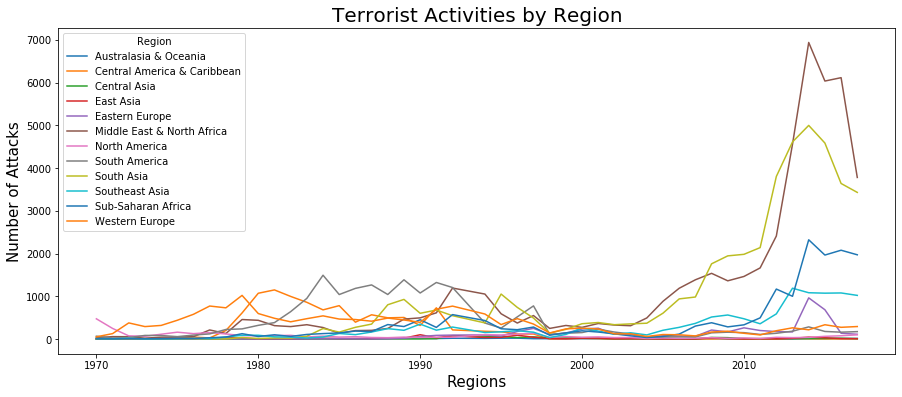

In [22]:
pd.crosstab(df.Year, df.Region).plot(kind='line',figsize=(15,6))
plt.title('Terrorist Activities by Region', size=20)
plt.xlabel('Regions', size=15)
plt.ylabel('Number of Attacks', size=15)
plt.show()

## Methods used for attack

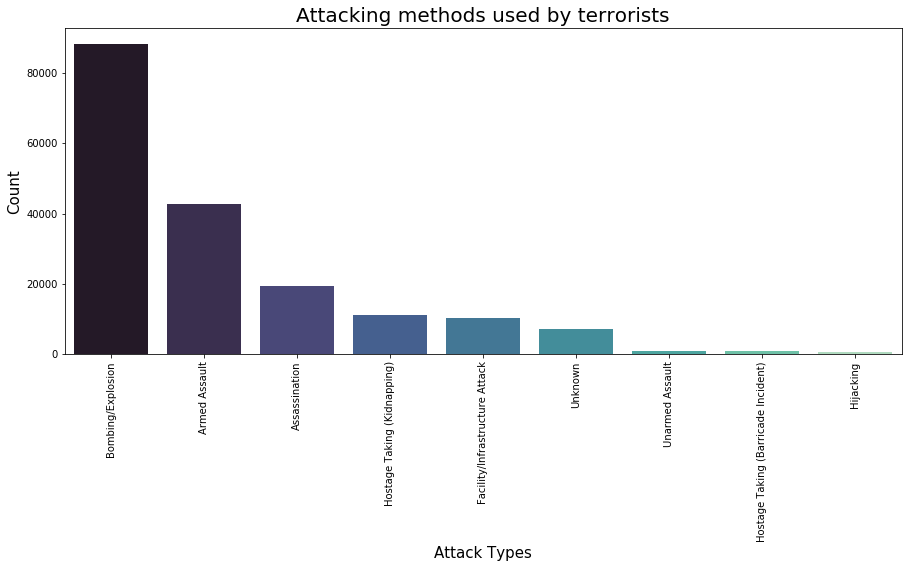

In [21]:
plt.subplots(figsize=(15,6))
sns.barplot(x=df['AttackType'].value_counts().index, y=df['AttackType'].value_counts().values,palette='mako')
plt.title('Attacking methods used by terrorists', size=20)
plt.xlabel('Attack Types', size=15)
plt.ylabel('Count', size=15)
plt.xticks(rotation= 90)
plt.show()

<font color=155E64>From the above plot we can see that Bombing/Explosion are mostly used for attacks</font>

### Major Targets for Attacks

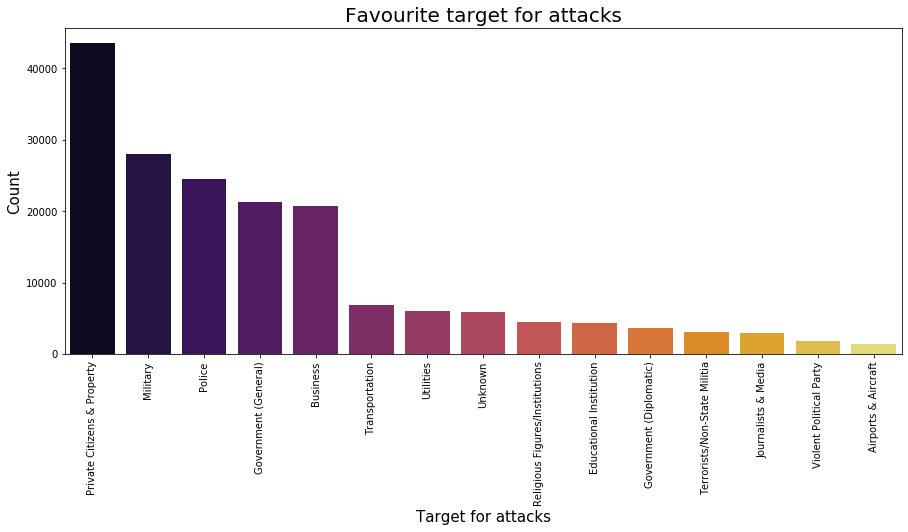

In [23]:
plt.subplots(figsize=(15,6))
sns.barplot(x=df['Target_type'].value_counts()[:15].index, y=df['Target_type'].value_counts()[:15].values,palette='inferno')
plt.title('Favourite target for attacks', size=20)
plt.xlabel('Target for attacks', size=15)
plt.ylabel('Count', size=15)
plt.xticks(rotation= 90)
plt.show()

<font color=155E64>Private citizens and property are the favourite target to attack</font>

## Top Terrorist Group

Text(0.5, 1.0, 'Attacks by Terrorist Groups')

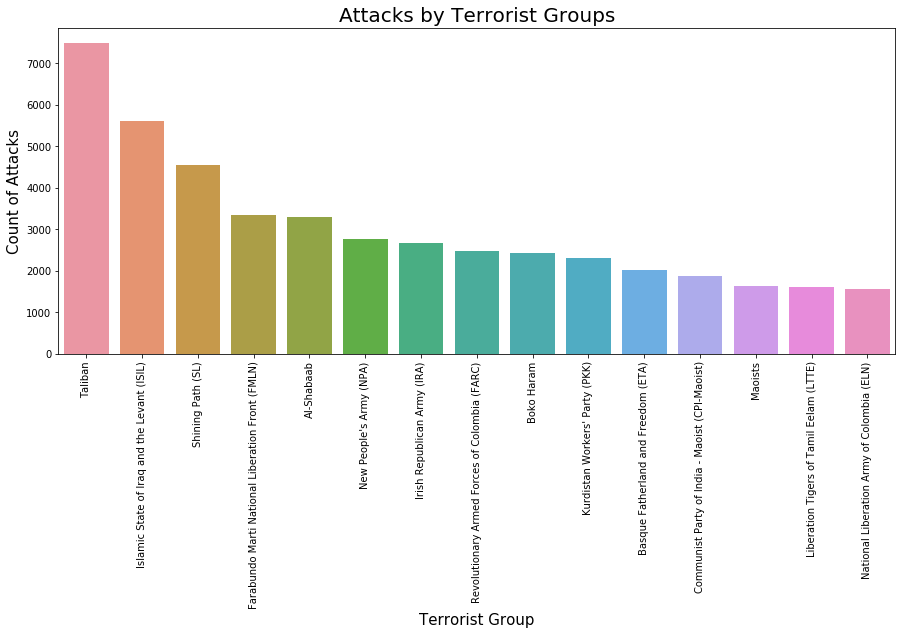

In [24]:
Name = df[df['Group'] == 'Unknown'].index
df.drop(Name , inplace=True)
plt.subplots(figsize=(15,6))
sns.barplot(x=df['Group'].value_counts().index[:15], y=df['Group'].value_counts().values[:15])
plt.xlabel("Terrorist Group", size=15)
plt.ylabel("Count of Attacks", size=15)
plt.xticks(rotation=90)
plt.title('Attacks by Terrorist Groups',size=20)

<font color=155E64>The maximum attacks were done by Taliban, Islamic State of Iraq and the Levant and Shining Path groups.</font>

## Total Attacks and People killed in each country

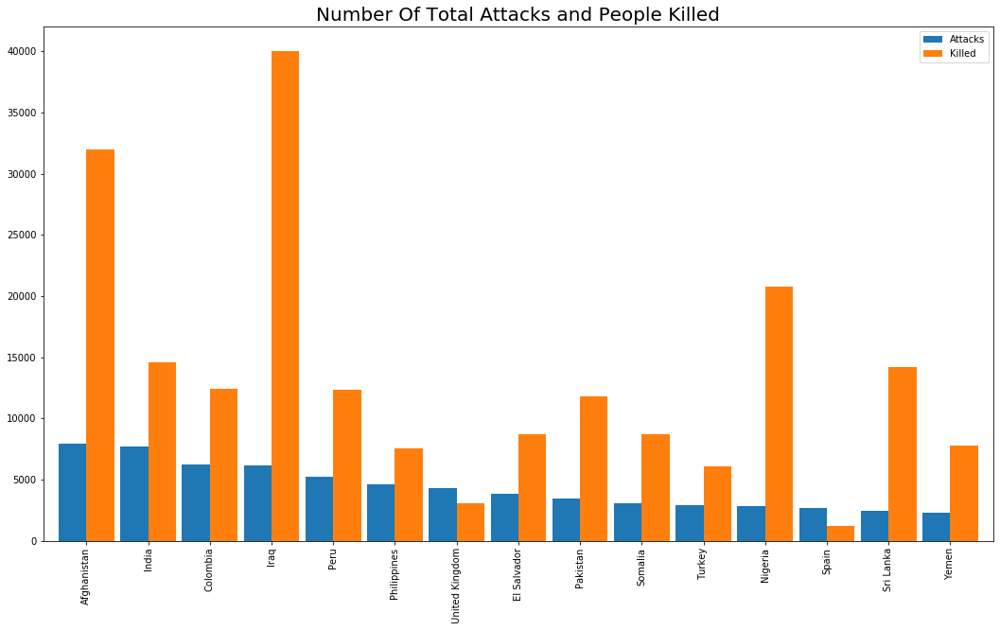

In [25]:
count = df['Country'].value_counts()[:15].to_frame()
count.columns=['Attacks']
df1=df.groupby('Country')['Killed'].sum().to_frame()
count.merge(df1,left_index=True,right_index=True,how='left').plot.bar(width=0.9)
fig=plt.gcf()
fig.set_size_inches(18,10)
plt.title('Number Of Total Attacks and People Killed', size=20)
plt.show()

<font color=155E64>Maximum number of people were from Iraq who were killed during the attacks.</font>

## Casuality in various Regions due to Terrorist Attacks

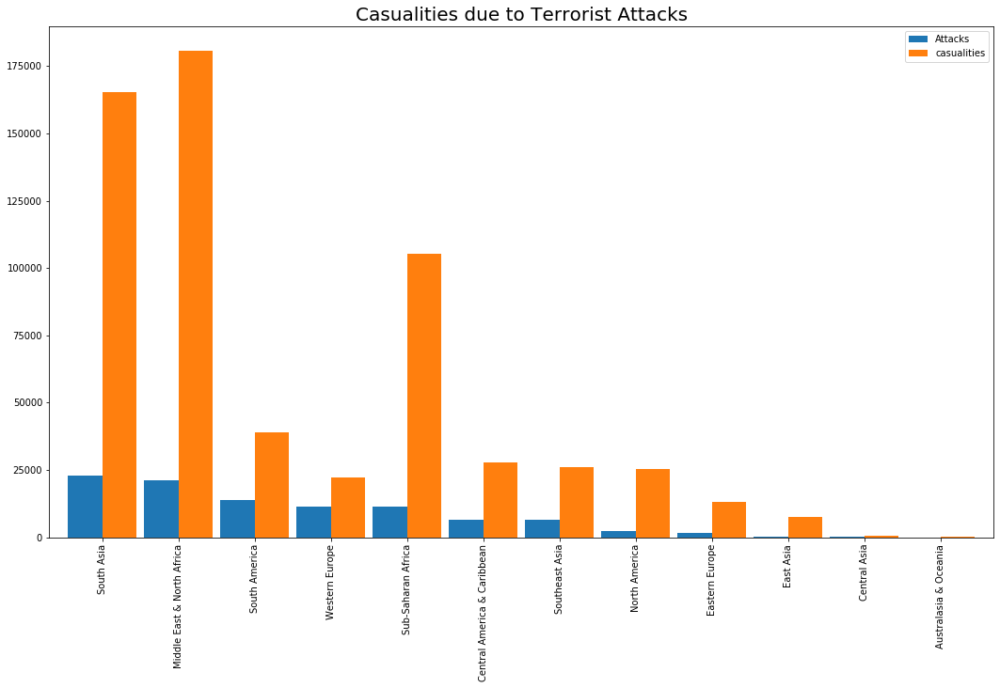

In [26]:
count = df['Region'].value_counts()[:15].to_frame()
count.columns=['Attacks']
df1=df.groupby('Region')['casualities'].sum().to_frame()
count.merge(df1,left_index=True,right_index=True,how='left').plot.bar(width=0.9)
fig=plt.gcf()
fig.set_size_inches(18,10)
plt.title('Casualities due to Terrorist Attacks', size=20)
plt.show()

<font color=155E64>Around 3,50,000 people were wounded and killed as the result of the attacks in Middle East and North Africa.</font>

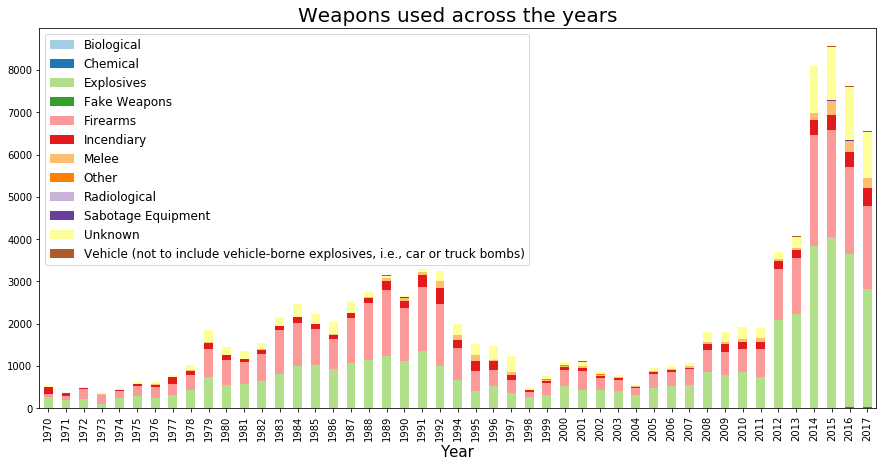

In [37]:
df2 = df.groupby(['Weapon_type', 'Year']).size().reset_index().pivot(columns='Weapon_type', index='Year', values=0)
df2.plot(kind = 'bar', stacked = True, figsize = (15,7), colormap = 'Paired')
plt.legend(loc=2, prop = {'size':12})
plt.xlabel("Year", size=15)
plt.title("Weapons used across the years", size=20)
plt.show()

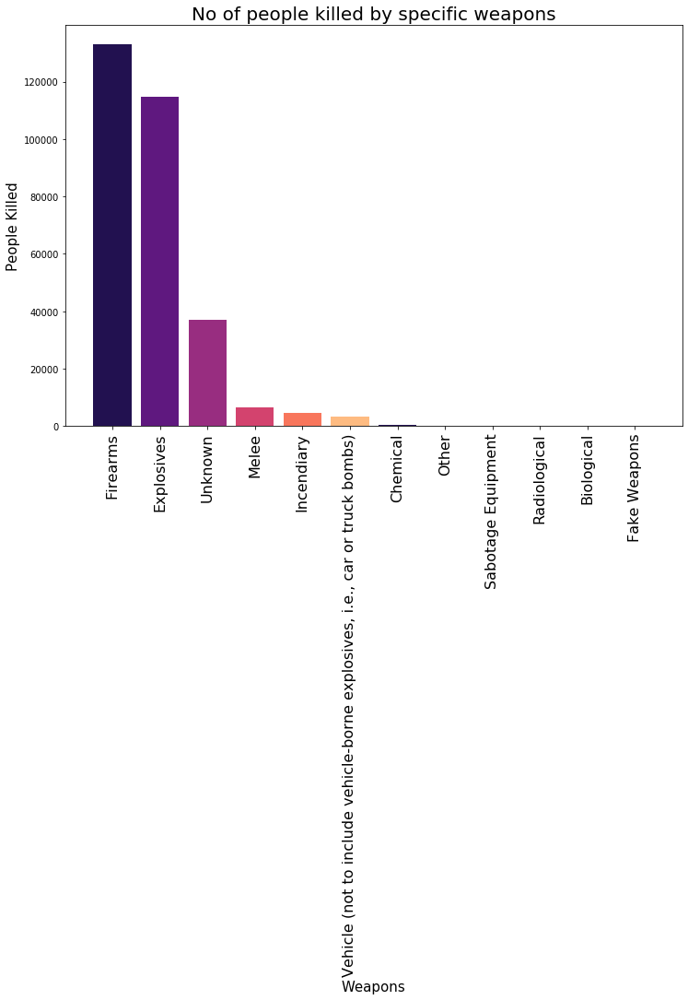

In [43]:
df3 = df[['Weapon_type','Killed']].groupby(by = 'Weapon_type').sum().sort_values('Killed', ascending=False)
plt.figure(figsize = (12,8))
plt.bar(x = df3.index, height = df3['Killed'], color = sns.color_palette('magma'))
plt.xticks(fontsize = 16, rotation = 90)
plt.xlabel('Weapons', size=15)
plt.ylabel("People Killed", size=15)
plt.title("No of people killed by specific weapons", size=20)
plt.show()

<font color=155E64>Explosives and Firearms seem to be the most fatal weapons contributing to a vast amount of deaths</font>

In [2]:

import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster, Fullscreen, MiniMap, HeatMap, HeatMapWithTime

In [7]:
filterYear = df['Year'] == 2015

In [8]:
df1 = df[filterYear] 
FilterData = df1.loc[:,'City':'longitude']
FilterData = FilterData.dropna()
FilterDataList = FilterData.values.tolist()

map = folium.Map(location = [0, 30], tiles='CartoDB positron', zoom_start=2)
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(FilterDataList)):
    folium.Marker(location=[FilterDataList[point][1],FilterDataList[point][2]],
                  popup = FilterDataList[point][0]).add_to(markerCluster)
map


In [9]:
year_list = []
for year in df['Year'].sort_values().unique():
    data = df.query('Year == @year')
    data = data.groupby(by=['latitude', 'longitude'], 
                        as_index=False).count().sort_values(by='EventId', ascending=False).iloc[:, :3]
    year_list.append(data.values.tolist())

m = folium.Map(
    location=[0, 0], 
    zoom_start=2.0, 
    
)

HeatMapWithTime(
    name='Terrorism Heatmap',
    data=year_list,
    radius=9,
    index=list(df['Year'].sort_values().unique())
).add_to(m)
m.save('terrorism_density_year.html')
m

<font color=155E64>Terrorist attackss in the Middle East and northern Africa have faced fatal consequences. The Middle East and North Africa are seen to be the places of serious terrorist attacks. f you look at the graphics, it appears that Iraq, Afghanistan and Pakistan are the most damaged countries.However the perception that muslim people support terrorism is totally </font>